<a href="https://colab.research.google.com/github/KENPHILIP/ML-PROJECTS/blob/main/loan_prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Loan Default Prediction
importing libraries

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import requests
import json
%matplotlib inline
from sklearn.preprocessing import LabelEncoder
from sklearn.tree import DecisionTreeClassifier
from sklearn.preprocessing import MinMaxScaler

In [ ]:
data=pd.read_csv("C:\\Users\\HP 820\\Desktop\\excel files\\loan.csv")

C:\Users\HP 820\AppData\Local\Temp\ipykernel_1824\3561814734.py:1: DtypeWarning: Columns (19,47,55,112,123,124,125,128,129,130,133,139,140,141) have mixed types. Specify dtype option on import or set low_memory=False.
  data=pd.read_csv("C:\\Users\\HP 820\\Desktop\\excel files\\loan.csv")


In [ ]:
data.shape

(2260668, 145)

In [ ]:
data.head(2)

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,...,hardship_payoff_balance_amount,hardship_last_payment_amount,disbursement_method,debt_settlement_flag,debt_settlement_flag_date,settlement_status,settlement_date,settlement_amount,settlement_percentage,settlement_term
0,NaN,NaN,2500,2500,2500.0,36 months,13.56,84.92,C,C1,...,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,30000,30000,30000.0,60 months,18.94,777.23,D,D2,...,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2260668 entries, 0 to 2260667
Columns: 145 entries, id to settlement_term
dtypes: float64(105), int64(4), object(36)
memory usage: 2.4+ GB


In [ ]:
data.describe()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,int_rate,installment,annual_inc,url,dti,...,deferral_term,hardship_amount,hardship_length,hardship_dpd,orig_projected_additional_accrued_interest,hardship_payoff_balance_amount,hardship_last_payment_amount,settlement_amount,settlement_percentage,settlement_term
count,0.0,0.0,2.260668e+06,2.260668e+06,2.260668e+06,2.260668e+06,2.260668e+06,2.260664e+06,0.0,2.258957e+06,...,10613.0,10613.000000,10613.0,10613.000000,8426.000000,10613.000000,10613.000000,33056.000000,33056.000000,33056.000000
mean,NaN,NaN,1.504693e+04,1.504166e+04,1.502344e+04,1.309291e+01,4.458076e+02,7.799243e+04,NaN,1.882420e+01,...,3.0,155.006696,3.0,13.686422,454.840802,11628.036442,193.606331,5030.606922,47.775600,13.148596
std,NaN,NaN,9.190245e+03,9.188413e+03,9.192332e+03,4.832114e+00,2.671737e+02,1.126962e+05,NaN,1.418333e+01,...,0.0,129.113137,0.0,9.728138,375.830737,7615.161123,198.694368,3692.027842,7.336379,8.192319
min,NaN,NaN,5.000000e+02,5.000000e+02,0.000000e+00,5.310000e+00,4.930000e+00,0.000000e+00,NaN,-1.000000e+00,...,3.0,0.640000,3.0,0.000000,1.920000,55.730000,0.010000,44.210000,0.200000,0.000000
25%,NaN,NaN,8.000000e+03,8.000000e+03,8.000000e+03,9.490000e+00,2.516500e+02,4.600000e+04,NaN,1.189000e+01,...,3.0,59.370000,3.0,5.000000,174.967500,5628.730000,43.780000,2227.000000,45.000000,6.000000
50%,NaN,NaN,1.290000e+04,1.287500e+04,1.280000e+04,1.262000e+01,3.779900e+02,6.500000e+04,NaN,1.784000e+01,...,3.0,119.040000,3.0,15.000000,352.605000,10044.220000,132.890000,4172.855000,45.000000,14.000000
75%,NaN,NaN,2.000000e+04,2.000000e+04,2.000000e+04,1.599000e+01,5.933200e+02,9.300000e+04,NaN,2.449000e+01,...,3.0,213.260000,3.0,22.000000,622.792500,16114.940000,284.180000,6870.782500,50.000000,18.000000
max,NaN,NaN,4.000000e+04,4.000000e+04,4.000000e+04,3.099000e+01,1.719830e+03,1.100000e+08,NaN,9.990000e+02,...,3.0,943.940000,3.0,37.000000,2680.890000,40306.410000,1407.860000,33601.000000,521.350000,181.000000


# Exploratory Data Analysis- 
plots for catecorical variables

C:\Users\HP 820\.anaconda\navigator\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='term', ylabel='count'>

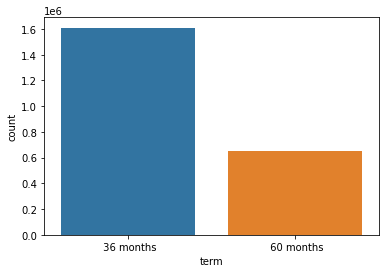

In [ ]:
sns.countplot(data['term'])

C:\Users\HP 820\.anaconda\navigator\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='grade', ylabel='count'>

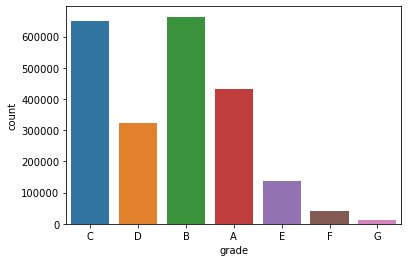

In [ ]:
sns.countplot(data['grade'])

<AxesSubplot:xlabel='grade', ylabel='count'>

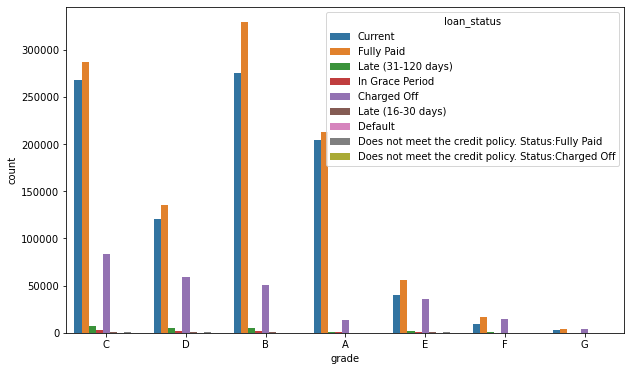

In [ ]:
plt.figure(figsize=(10,6))
sns.countplot(x="grade", hue="loan_status", data=data)

In [ ]:
data["grade"].unique()

array(['C', 'D', 'B', 'A', 'E', 'F', 'G'], dtype=object)

In [ ]:
data['grade'].value_counts()

B    663557
C    650053
A    433027
D    324424
E    135639
F     41800
G     12168
Name: grade, dtype: int64

In [ ]:
data[data["grade"]=="A"].groupby("loan_status")["grade"].count()
#*100/len(data[data["grade"]=="A"])

loan_status
Charged Off                                             13766
Current                                                204435
Default                                                     2
Does not meet the credit policy. Status:Charged Off         8
Does not meet the credit policy. Status:Fully Paid         90
Fully Paid                                             212477
In Grace Period                                           668
Late (16-30 days)                                         267
Late (31-120 days)                                       1314
Name: grade, dtype: int64

In [ ]:
data[data["grade"]=="B"].groupby("loan_status")["grade"].count()

loan_status
Charged Off                                             51077
Current                                                275455
Default                                                     6
Does not meet the credit policy. Status:Charged Off        85
Does not meet the credit policy. Status:Fully Paid        269
Fully Paid                                             329075
In Grace Period                                          2008
Late (16-30 days)                                         824
Late (31-120 days)                                       4758
Name: grade, dtype: int64

In [ ]:
data[data["grade"]=="C"].groupby("loan_status")["grade"].count()

loan_status
Charged Off                                             83262
Current                                                267326
Default                                                     9
Does not meet the credit policy. Status:Charged Off       148
Does not meet the credit policy. Status:Fully Paid        481
Fully Paid                                             286666
In Grace Period                                          3194
Late (16-30 days)                                        1327
Late (31-120 days)                                       7640
Name: grade, dtype: int64

In [ ]:
data[data["grade"]=="D"].groupby("loan_status")["grade"].count()

loan_status
Charged Off                                             59441
Current                                                120666
Default                                                     8
Does not meet the credit policy. Status:Charged Off       197
Does not meet the credit policy. Status:Fully Paid        494
Fully Paid                                             135839
In Grace Period                                          1965
Late (16-30 days)                                         829
Late (31-120 days)                                       4985
Name: grade, dtype: int64

In [ ]:
data[data["grade"]=="E"].groupby("loan_status")["grade"].count()

loan_status
Charged Off                                            35364
Current                                                40174
Default                                                    4
Does not meet the credit policy. Status:Charged Off      158
Does not meet the credit policy. Status:Fully Paid       378
Fully Paid                                             56206
In Grace Period                                          794
Late (16-30 days)                                        335
Late (31-120 days)                                      2226
Name: grade, dtype: int64

In [ ]:
data[data["grade"]=="F"].groupby("loan_status")["grade"].count()

loan_status
Charged Off                                            14263
Current                                                 9006
Default                                                    2
Does not meet the credit policy. Status:Charged Off       93
Does not meet the credit policy. Status:Fully Paid       154
Fully Paid                                             17220
In Grace Period                                          230
Late (16-30 days)                                        114
Late (31-120 days)                                       718
Name: grade, dtype: int64

In [ ]:
data[data["grade"]=="G"].groupby("loan_status")["grade"].count()

loan_status
Charged Off                                            4482
Current                                                2633
Does not meet the credit policy. Status:Charged Off      72
Does not meet the credit policy. Status:Fully Paid      122
Fully Paid                                             4469
In Grace Period                                          93
Late (16-30 days)                                        41
Late (31-120 days)                                      256
Name: grade, dtype: int64

In [ ]:
data["sub_grade"].unique()

array(['C1', 'D2', 'D1', 'C4', 'C3', 'C2', 'D5', 'B3', 'A4', 'B5', 'C5',
       'D4', 'E1', 'E4', 'B4', 'D3', 'A1', 'E5', 'B2', 'B1', 'A5', 'F5',
       'A3', 'E3', 'A2', 'E2', 'F4', 'G1', 'G2', 'F1', 'F2', 'F3', 'G4',
       'G3', 'G5'], dtype=object)

In [ ]:
sub_order=sorted(data["sub_grade"].unique())

<AxesSubplot:xlabel='sub_grade', ylabel='count'>

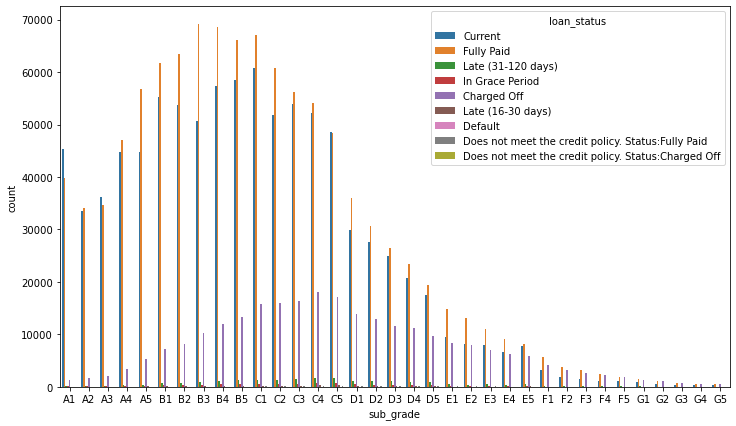

In [ ]:
plt.figure(figsize=(12,7))
sns.countplot(x="sub_grade", hue="loan_status",order=sub_order, data=data)

In [ ]:
#sns.countplot(data['emp_title'])

In [ ]:
data['emp_length'].value_counts()

10+ years    748005
2 years      203677
< 1 year     189988
3 years      180753
1 year       148403
5 years      139698
4 years      136605
6 years      102628
7 years       92695
8 years       91914
9 years       79395
Name: emp_length, dtype: int64

<AxesSubplot:xlabel='emp_length', ylabel='count'>

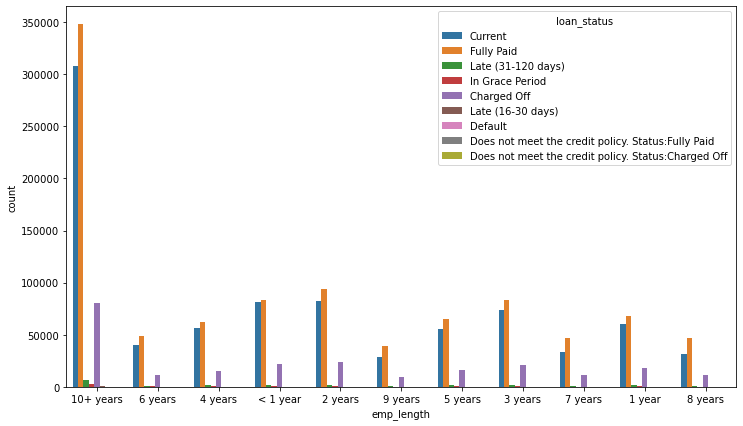

In [ ]:
plt.figure(figsize=(12,7))
sns.countplot(x="emp_length", hue="loan_status", data=data)

In [ ]:
data['verification_status'].value_counts()

Source Verified    886231
Not Verified       744806
Verified           629631
Name: verification_status, dtype: int64

C:\Users\HP 820\.anaconda\navigator\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='verification_status', ylabel='count'>

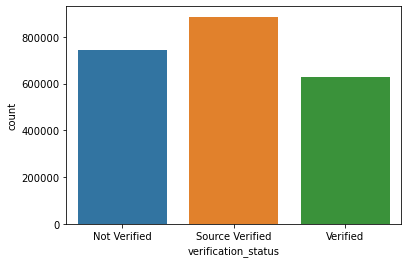

In [ ]:
sns.countplot(data['verification_status'])

<AxesSubplot:xlabel='verification_status', ylabel='count'>

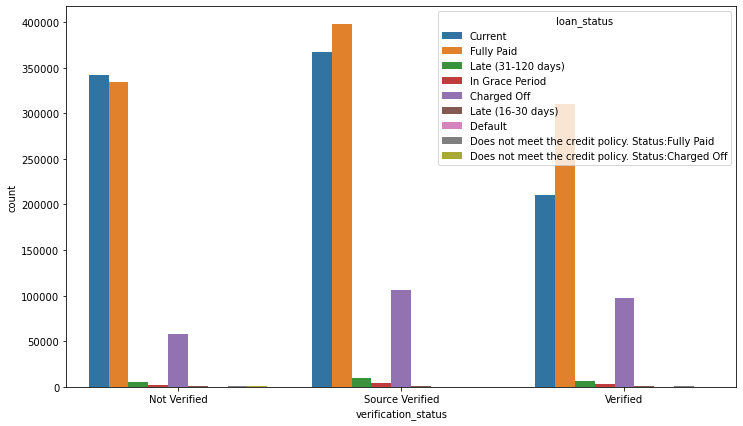

In [ ]:
plt.figure(figsize=(12,7))
sns.countplot(x="verification_status", hue="loan_status", data=data)

In [ ]:
data['home_ownership'].value_counts()

MORTGAGE    1111450
RENT         894929
OWN          253057
ANY             996
OTHER           182
NONE             54
Name: home_ownership, dtype: int64

C:\Users\HP 820\.anaconda\navigator\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='home_ownership', ylabel='count'>

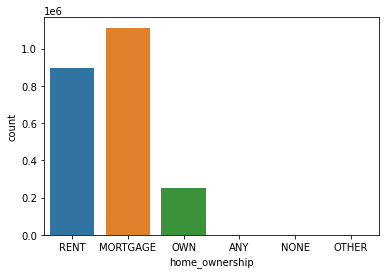

In [ ]:
sns.countplot(data['home_ownership'])

In [ ]:
data['loan_status'].value_counts()*100/len(data)

Fully Paid                                             46.090448
Current                                                40.682444
Charged Off                                            11.574234
Late (31-120 days)                                      0.968608
In Grace Period                                         0.395989
Late (16-30 days)                                       0.165305
Does not meet the credit policy. Status:Fully Paid      0.087939
Does not meet the credit policy. Status:Charged Off     0.033663
Default                                                 0.001371
Name: loan_status, dtype: float64

In [ ]:
data['loan_status'].value_counts()

Fully Paid                                             1041952
Current                                                 919695
Charged Off                                             261655
Late (31-120 days)                                       21897
In Grace Period                                           8952
Late (16-30 days)                                         3737
Does not meet the credit policy. Status:Fully Paid        1988
Does not meet the credit policy. Status:Charged Off        761
Default                                                     31
Name: loan_status, dtype: int64

<AxesSubplot:xlabel='loan_status', ylabel='Count'>

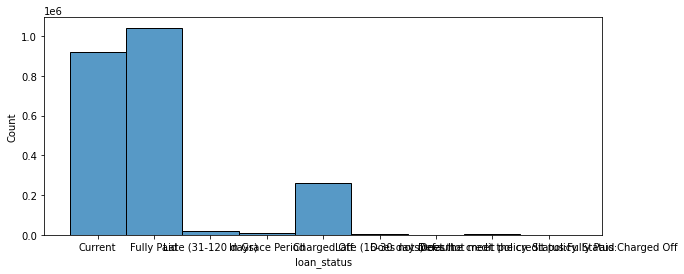

In [ ]:
plt.figure(figsize=(10,4))
sns.histplot(data['loan_status'])

In [ ]:
data['purpose'].value_counts()

debt_consolidation    1277877
credit_card            516971
home_improvement       150457
other                  139440
major_purchase          50445
medical                 27488
small_business          24689
car                     24013
vacation                15525
moving                  15403
house                   14136
wedding                  2355
renewable_energy         1445
educational               424
Name: purpose, dtype: int64

<AxesSubplot:xlabel='purpose', ylabel='Count'>

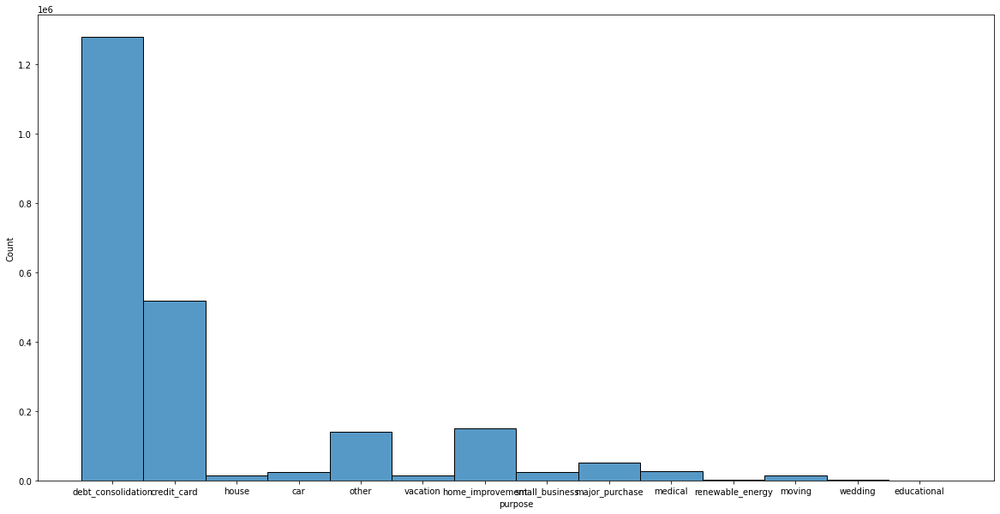

In [ ]:
plt.figure(figsize=(20,10))
sns.histplot(data['purpose'])

# Data Cleaning1-missing values

In [ ]:
data.dtypes.value_counts()

float64    105
object      36
int64        4
dtype: int64

# -drop variables with 50% of missing values

In [ ]:
data1=data.drop(data.columns[data.isnull().mean()>0.50],
                              axis=1)
data1.shape

(2260668, 101)

In [ ]:
data1.dtypes.value_counts()

float64    75
object     22
int64       4
dtype: int64

In [ ]:
data1.select_dtypes(include=object).head()

,term,grade,sub_grade,emp_title,emp_length,home_ownership,verification_status,issue_d,loan_status,pymnt_plan,...,zip_code,addr_state,earliest_cr_line,initial_list_status,last_pymnt_d,last_credit_pull_d,application_type,hardship_flag,disbursement_method,debt_settlement_flag
0,36 months,C,C1,Chef,10+ years,RENT,Not Verified,Dec-2018,Current,n,...,109xx,NY,Apr-2001,w,Feb-2019,Feb-2019,Individual,N,Cash,N
1,60 months,D,D2,Postmaster,10+ years,MORTGAGE,Source Verified,Dec-2018,Current,n,...,713xx,LA,Jun-1987,w,Feb-2019,Feb-2019,Individual,N,Cash,N
2,36 months,D,D1,Administrative,6 years,MORTGAGE,Source Verified,Dec-2018,Current,n,...,490xx,MI,Apr-2011,w,Feb-2019,Feb-2019,Individual,N,Cash,N
3,36 months,D,D2,IT Supervisor,10+ years,MORTGAGE,Source Verified,Dec-2018,Current,n,...,985xx,WA,Feb-2006,w,Feb-2019,Feb-2019,Individual,N,Cash,N
4,60 months,C,C4,Mechanic,10+ years,MORTGAGE,Not Verified,Dec-2018,Current,n,...,212xx,MD,Dec-2000,w,Feb-2019,Feb-2019,Individual,N,Cash,N


# Data Cleaning2-drop low var()  variables
(all those with zero values)

In [ ]:
data2=data1.drop(data1.columns[data1.isnull().var()==0.0],axis=1)

In [ ]:
data2.shape

(2260668, 69)

In [ ]:
data2.dtypes.value_counts()

float64    62
object      7
dtype: int64

In [ ]:
data2.head()

,emp_title,emp_length,annual_inc,title,zip_code,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,open_acc,...,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit
0,Chef,10+ years,55000.0,Debt consolidation,109xx,18.24,0.0,Apr-2001,1.0,9.0,...,0.0,3.0,100.0,0.0,1.0,0.0,60124.0,16901.0,36500.0,18124.0
1,Postmaster,10+ years,90000.0,Debt consolidation,713xx,26.52,0.0,Jun-1987,0.0,13.0,...,0.0,6.0,95.0,0.0,1.0,0.0,372872.0,99468.0,15000.0,94072.0
2,Administrative,6 years,59280.0,Debt consolidation,490xx,10.51,0.0,Apr-2011,0.0,8.0,...,0.0,0.0,100.0,0.0,0.0,0.0,136927.0,11749.0,13800.0,10000.0
3,IT Supervisor,10+ years,92000.0,Debt consolidation,985xx,16.74,0.0,Feb-2006,0.0,10.0,...,0.0,3.0,100.0,100.0,0.0,0.0,385183.0,36151.0,5000.0,44984.0
4,Mechanic,10+ years,57250.0,Debt consolidation,212xx,26.35,0.0,Dec-2000,0.0,12.0,...,0.0,5.0,92.3,0.0,0.0,0.0,157548.0,29674.0,9300.0,32332.0


In [ ]:
data2.select_dtypes(include=object).head()

,emp_title,emp_length,title,zip_code,earliest_cr_line,last_pymnt_d,last_credit_pull_d
0,Chef,10+ years,Debt consolidation,109xx,Apr-2001,Feb-2019,Feb-2019
1,Postmaster,10+ years,Debt consolidation,713xx,Jun-1987,Feb-2019,Feb-2019
2,Administrative,6 years,Debt consolidation,490xx,Apr-2011,Feb-2019,Feb-2019
3,IT Supervisor,10+ years,Debt consolidation,985xx,Feb-2006,Feb-2019,Feb-2019
4,Mechanic,10+ years,Debt consolidation,212xx,Dec-2000,Feb-2019,Feb-2019


# Data Cleaning 3- fillna

In [ ]:
###fillna categorical variables

col=data2[['emp_title',
 'emp_length',
 'title',
 'zip_code',
 'earliest_cr_line',
 'last_pymnt_d',
 'last_credit_pull_d']]

for i in col:
  data2[i].fillna(data2[i].mode().iloc[0],inplace=True)

In [ ]:
data2.isnull().sum()

emp_title                         0
emp_length                        0
annual_inc                        4
title                             0
zip_code                          0
                              ...  
tax_liens                       105
tot_hi_cred_lim               70276
total_bal_ex_mort             50030
total_bc_limit                50030
total_il_high_credit_limit    70276
Length: 69, dtype: int64

In [ ]:
###fillna numeric variables
###list(data2.select_dtypes(include=np.number))
cols=data2[['annual_inc','dti','delinq_2yrs','inq_last_6mths','open_acc',
 'pub_rec','revol_util','total_acc','collections_12_mths_ex_med','acc_now_delinq',
 'tot_coll_amt','tot_cur_bal','open_acc_6m','open_act_il','open_il_12m','open_il_24m',
 'mths_since_rcnt_il','total_bal_il','il_util','open_rv_12m','open_rv_24m','max_bal_bc',
 'all_util','total_rev_hi_lim','inq_fi','total_cu_tl','inq_last_12m','acc_open_past_24mths',
 'avg_cur_bal','bc_open_to_buy','bc_util','chargeoff_within_12_mths', 'delinq_amnt',
 'mo_sin_old_il_acct','mo_sin_old_rev_tl_op','mo_sin_rcnt_rev_tl_op','mo_sin_rcnt_tl',
 'mort_acc','mths_since_recent_bc','mths_since_recent_inq','num_accts_ever_120_pd',
 'num_actv_bc_tl','num_actv_rev_tl','num_bc_sats','num_bc_tl','num_il_tl',
 'num_op_rev_tl','num_rev_accts','num_rev_tl_bal_gt_0','num_sats','num_tl_120dpd_2m',
 'num_tl_30dpd','num_tl_90g_dpd_24m','num_tl_op_past_12m','pct_tl_nvr_dlq','percent_bc_gt_75',
 'pub_rec_bankruptcies','tax_liens','tot_hi_cred_lim','total_bal_ex_mort',
 'total_bc_limit','total_il_high_credit_limit']]

for i in cols:
  data2[i].fillna(data2[i].mean(),inplace=True)

In [ ]:
data2.isnull().sum()

emp_title                     0
emp_length                    0
annual_inc                    0
title                         0
zip_code                      0
                             ..
tax_liens                     0
tot_hi_cred_lim               0
total_bal_ex_mort             0
total_bc_limit                0
total_il_high_credit_limit    0
Length: 69, dtype: int64

# Exploratory Data Analysis-
histogram for numeric variables

<AxesSubplot:>

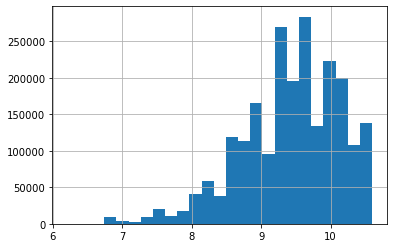

In [ ]:
data['loan_amnt_log'] = np.log(data['loan_amnt'])
data['loan_amnt_log'].hist(bins=25)


<AxesSubplot:>

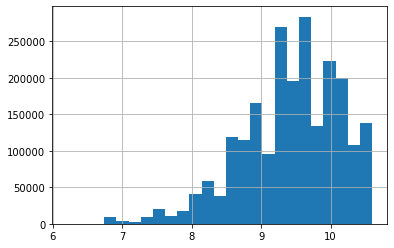

In [ ]:
data['funded_amnt_log'] = np.log(data['funded_amnt'])
data['funded_amnt_log'].hist(bins=25)

<AxesSubplot:>

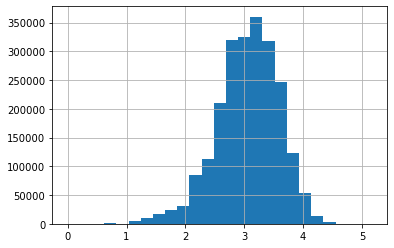

In [ ]:
data['total_acc_log'] = np.log(data['total_acc'])
data['total_acc_log'].hist(bins=25)

In [ ]:
data2.corr()

,annual_inc,dti,delinq_2yrs,inq_last_6mths,open_acc,pub_rec,revol_util,total_acc,collections_12_mths_ex_med,acc_now_delinq,...,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit
annual_inc,1.000000,-0.082604,0.026134,0.020001,0.094377,-0.002543,0.028194,0.115271,-0.003484,0.007322,...,0.003918,0.034117,-0.004852,-0.003155,-0.027128,0.024444,0.263574,0.206539,0.176975,0.174431
dti,-0.082604,1.000000,-0.012209,-0.012186,0.186060,-0.026025,0.114902,0.147283,-0.007024,-0.000195,...,-0.013287,0.045030,0.064941,0.102797,-0.012374,-0.020503,0.031064,0.193084,0.037533,0.218239
delinq_2yrs,0.026134,-0.012209,1.000000,0.024260,0.048956,-0.021810,-0.000200,0.118554,0.071874,0.116076,...,0.652864,-0.022004,-0.439711,-0.000499,-0.049301,0.011384,0.056288,0.028043,-0.077755,0.056223
inq_last_6mths,0.020001,-0.012186,0.024260,1.000000,0.138064,0.064950,-0.078497,0.154855,0.011227,-0.001463,...,0.028843,0.317134,-0.027086,-0.059607,0.073674,0.013747,0.029920,0.036024,-0.002784,0.042621
open_acc,0.094377,0.186060,0.048956,0.138064,1.000000,-0.014849,-0.134523,0.717911,0.007967,0.016877,...,0.010650,0.367584,0.109123,-0.086537,-0.016406,-0.005172,0.294525,0.402391,0.380744,0.364237
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
tax_liens,0.024444,-0.020503,0.011384,0.013747,-0.005172,0.697894,-0.002836,-0.015105,0.010757,0.007868,...,0.002231,0.017482,-0.032248,-0.009838,0.033034,1.000000,-0.000093,-0.001037,-0.025517,0.005358
tot_hi_cred_lim,0.263574,0.031064,0.056288,0.029920,0.294525,-0.070120,0.029182,0.343563,-0.012942,0.023216,...,0.003967,0.101189,0.024251,-0.009157,-0.100289,-0.000093,1.000000,0.519240,0.402764,0.425133
total_bal_ex_mort,0.206539,0.193084,0.028043,0.036024,0.402391,-0.054381,0.124504,0.435480,-0.013295,0.006946,...,0.014325,0.119055,0.061378,0.069999,-0.072824,-0.001037,0.519240,1.000000,0.296039,0.874954
total_bc_limit,0.176975,0.037533,-0.077755,-0.002784,0.380744,-0.125087,-0.173292,0.290811,-0.028357,0.002557,...,-0.059031,0.051356,0.215752,-0.211393,-0.143135,-0.025517,0.402764,0.296039,1.000000,0.140657


In [ ]:
purpose = data.groupby('purpose')[['verification_status', 'dti']].sum()
purpose

,dti
purpose,
car,372092.12
credit_card,9835425.58
debt_consolidation,24866651.02
educational,4778.07
home_improvement,2548787.77
house,212077.75
major_purchase,780992.41
medical,504529.88
moving,266399.23


In [ ]:
pur = np.array(['car', 'credit card', 'consolidation', 'education', 'home furnish', 'house', 'purchase', 'medical', 'travel', 'other', 'consumption', 'business', 'vacation', 'wedding'])

<AxesSubplot:>

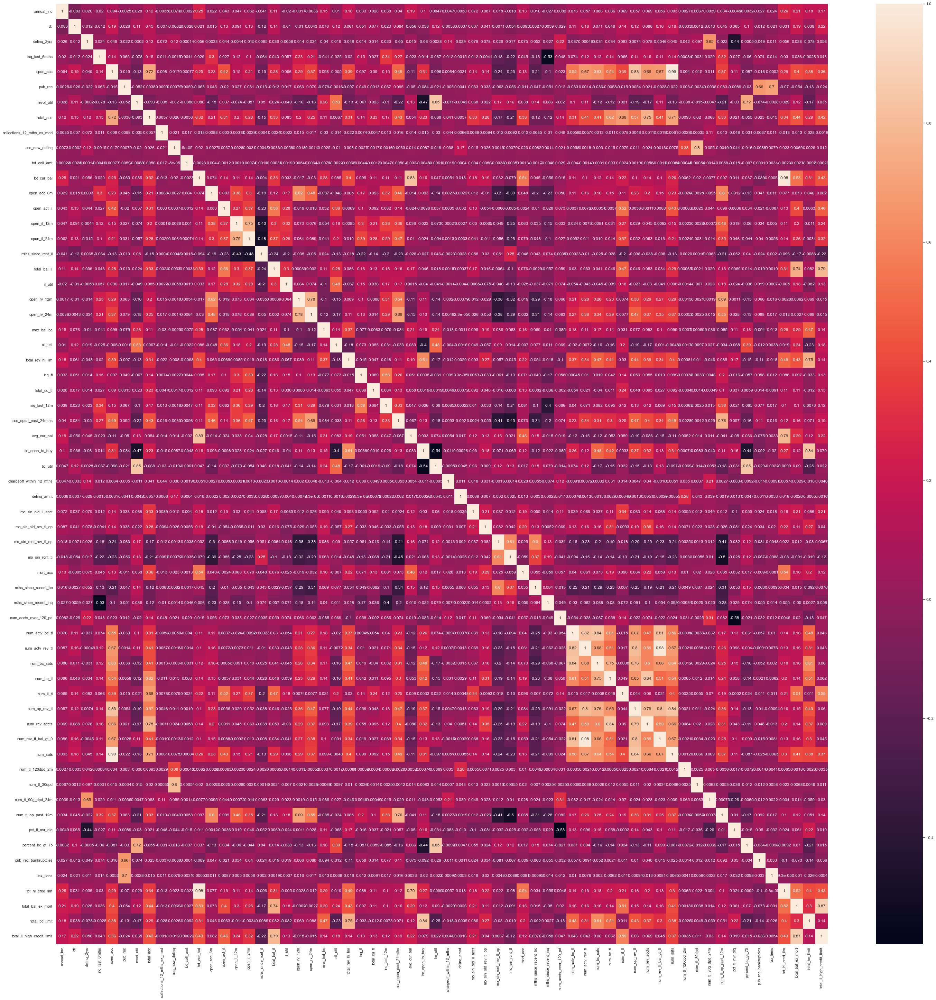

In [ ]:
sns.set(rc={"figure.figsize":(50,50)})
#plt.figure(figsize=(200,200))
sns.heatmap(data2.corr(),annot=True)

# Data Cleaning 4- encoding

In [ ]:
cols=['emp_title',
 'emp_length',
 'title',
 'zip_code',
 'earliest_cr_line',
 'last_pymnt_d',
 'last_credit_pull_d']
le=LabelEncoder()
for col in cols:
    data2[col]=le.fit_transform(data2[col])

In [ ]:
###convert string variables to float

In [ ]:
data2['emp_title']=data2['emp_title'].astype(float)

In [ ]:
data2['emp_length']=data2['emp_length'].astype(float)

In [ ]:
employees_grouped=data.groupby("emp_title")["funded_amnt", "installment","loan_amnt"].sum().reset_index()
plt.figure(figsize=(10,8))
temp=employees_grouped[["emp_title","loan_amnt"]]
temp=temp.sort_values(by="loan_amnt",ascending=False)
temp=temp[temp["loan_amnt"]>0]
temp.style.background_gradient(cmap='BuGn_r')

C:\Users\HP 820\AppData\Local\Temp\ipykernel_1824\4042463315.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  employees_grouped=data.groupby("emp_title")["funded_amnt", "installment","loan_amnt"].sum().reset_index()


<Figure size 720x576 with 0 Axes>

In [ ]:
data2['title']=data2['title'].astype(float)

In [ ]:
data2['zip_code']=data2['zip_code'].astype(float)

In [ ]:
data2['earliest_cr_line']=data2['earliest_cr_line'].astype(float)

In [ ]:
data2['last_pymnt_d']=data2['last_pymnt_d'].astype(float)

In [ ]:
data2['last_credit_pull_d']=data2['last_credit_pull_d'].astype(float)

In [ ]:
#V= 'loan_status'
#def get_int_or_float(v):
   # number_as_float = float(v)
   # number_as_int = int(number_as_float)
    #return number_as_int if number_as_float == number_as_int else number_as_float
           

In [ ]:
data = data[data['loan_status'] != 'Current']

In [ ]:
data['loan_status'] = data['loan_status'].replace({
    'Current': 0,
    'Fully Paid': 1,
    'Late (31-120 days)': 2,
    'Late (16-30 days)': 3,
    'Charged Off': 4,
    'In Grace Period': 5,
    'Default': 6
})

In [ ]:
data2.head()

,emp_title,emp_length,annual_inc,title,zip_code,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,open_acc,...,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit
0,72085.0,1.0,55000.0,16586.0,101.0,18.24,0.0,46.0,1.0,9.0,...,0.0,3.0,100.0,0.0,1.0,0.0,60124.0,16901.0,36500.0,18124.0
1,299234.0,1.0,90000.0,16586.0,682.0,26.52,0.0,414.0,0.0,13.0,...,0.0,6.0,95.0,0.0,1.0,0.0,372872.0,99468.0,15000.0,94072.0
2,15072.0,6.0,59280.0,16586.0,477.0,10.51,0.0,56.0,0.0,8.0,...,0.0,0.0,100.0,0.0,0.0,0.0,136927.0,11749.0,13800.0,10000.0
3,195310.0,1.0,92000.0,16586.0,941.0,16.74,0.0,239.0,0.0,10.0,...,0.0,3.0,100.0,100.0,0.0,0.0,385183.0,36151.0,5000.0,44984.0
4,249161.0,1.0,57250.0,16586.0,203.0,26.35,0.0,173.0,0.0,12.0,...,0.0,5.0,92.3,0.0,0.0,0.0,157548.0,29674.0,9300.0,32332.0


In [ ]:
data2.isnull().sum().sum()

0

# Model

In [ ]:
#data['loan_status'].isnull().sum()
y=data['loan_status']

In [ ]:
series=data['loan_status']

In [ ]:
X=data2.iloc[:,:].drop_duplicates(inplace=True)

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
from imblearn.over_sampling import SMOTE
from sklearn.datasets import make_classification
from collections import Counter

# Generate an imbalanced dataset
X, y = make_classification(n_classes=2, class_sep=2,
                            weights=[0.1, 0.9], n_informative=3,
                            n_redundant=1, flip_y=0, n_features=20,
                            n_clusters_per_class=1, n_samples=1000,
                            random_state=10)

print('Original dataset shape %s' % Counter(y))

# Apply SMOTE to balance the dataset
sm = SMOTE(random_state=42)
X_res, y_res = sm.fit_resample(X, y)

print('Resampled dataset shape %s' % Counter(y_res))


Original dataset shape Counter({1: 900, 0: 100})
Resampled dataset shape Counter({0: 900, 1: 900})


In [ ]:
scaler=MinMaxScaler()
#fit the scaler to the data
scaler.fit(data2)

#transform the data using the scaler
scaled_data= scaler.transform(data2)

print(scaled_data)

[[1.40600710e-01 1.00000000e-01 5.00000000e-04 ... 4.95907538e-03
  2.32632250e-02 8.55310723e-03]
 [5.83651425e-01 1.00000000e-01 8.18181818e-04 ... 2.91858061e-02
  9.56022945e-03 4.43946095e-02]
 [2.93977097e-02 6.00000000e-01 5.38909091e-04 ... 3.44738043e-03
  8.79541109e-03 4.71921608e-03]
 ...
 [7.92329913e-01 1.00000000e-01 5.81818182e-04 ... 1.06945376e-02
  1.27469726e-03 1.38353258e-02]
 [7.92329913e-01 1.00000000e-01 5.45454545e-04 ... 1.91420720e-02
  1.40216699e-02 3.86857738e-02]
 [7.73445317e-02 3.00000000e-01 5.45454545e-04 ... 7.55847475e-03
  1.24282983e-02 0.00000000e+00]]


In [ ]:
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import train_test_split
from sklearn.datasets import make_classification

# create an imbalanced dataset
X, y = make_classification(n_classes=2, class_sep=2,
                           weights=[0.9, 0.1], n_informative=3,
                           n_redundant=1, flip_y=0, n_features=20,
                           n_clusters_per_class=1, n_samples=1000,
                           random_state=10)

# split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=10)

# apply SMOTE to balance the dataset
sm = SMOTE(random_state=42)
X_train_res, y_train_res = sm.fit_resample(X_train, y_train)

# print the number of samples in each class before and after balancing
print("Before balancing:", len(y_train), "ones:", sum(y_train==1), "zeros:", sum(y_train==0))
print("After balancing:", len(y_train_res), "ones:", sum(y_train_res==1), "zeros:", sum(y_train_res==0))

Before balancing: 700 ones: 68 zeros: 632
After balancing: 1264 ones: 632 zeros: 632


In [ ]:
X_train.shape


(700, 20)

In [ ]:
y_train.shape

(700,)

In [ ]:
X_test.shape

(300, 20)

In [ ]:
y_test.shape

(300,)

In [ ]:
from sklearn.linear_model import LinearRegression

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix

In [ ]:
from sklearn.preprocessing import LabelEncoder

# Create a LabelEncoder object
label_encoder = LabelEncoder()

# Fit and transform the loan_status column in y_train
y_train = label_encoder.fit_transform(y_train)
Regression = LinearRegression()
Regression.fit(X_train, y_train)

LinearRegression()

In [ ]:
ypred = Regression.predict(X_test)

In [ ]:
import xgboost as xgb

In [ ]:
xg = xgb.XGBRegressor(objective='reg:linear', colsample_bytree=0.3, learning_rate=0.1, max_depth=10, alpha=10, max_estimators=8)
xg.fit(X_train, y_train)

[08:35:26] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-0fc7796c793e6356f-1/xgboost/xgboost-ci-windows/src/objective/regression_obj.cu:213: reg:linear is now deprecated in favor of reg:squarederror.
[08:35:26] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-0fc7796c793e6356f-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "max_estimators" } are not used.



XGBRegressor(alpha=10, base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=0.3, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.1, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=10, max_estimators=8,
             max_leaves=None, min_child_weight=None, missing=nan,
             monotone_constraints=None, n_estimators=100, n_jobs=None,
             num_parallel_tree=None, ...)

In [ ]:
ypred = Regression.predict(X_test)

In [ ]:

Regression.score(X_test, ypred) * 100

100.0

In [ ]:
from sklearn.model_selection import train_test_split


# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=44)

# Train a random forest classifier on the training data
from sklearn.ensemble import RandomForestClassifier
rf_model = RandomForestClassifier(n_estimators=50, max_features="auto", random_state=44)
rf_model.fit(X_train, y_train)

# Test the model on the testing data
pred_test = rf_model.predict(X_test)
pred_train = rf_model.predict(X_train)

In [ ]:
pred_test,y_test

(array([0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,
        1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1,
        0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1,
        0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1,
        0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0,
        0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 

In [ ]:
from sklearn.model_selection import train_test_split

# Assuming you have your data stored in X and y variables
# Splitting the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Splitting the training set into training and validation sets
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.25, random_state=42)

# Printing the shapes of the resulting datasets
print("Training set shapes: X_train = {}, y_train = {}".format(X_train.shape, y_train.shape))
print("Validation set shapes: X_val = {}, y_val = {}".format(X_val.shape, y_val.shape))
print("Testing set shapes: X_test = {}, y_test = {}".format(X_test.shape, y_test.shape))


Training set shapes: X_train = (600, 20), y_train = (600,)
Validation set shapes: X_val = (200, 20), y_val = (200,)
Testing set shapes: X_test = (200, 20), y_test = (200,)


In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
# Split data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
# Train a logistic regression model
model = LogisticRegression()
model.fit(X_train, y_train)
# Make predictions on the test set
ypred = model.predict(X_test)
# Find accuracy, precision, recall, and f1 score
accuracy = accuracy_score(y_test, ypred)
precision = precision_score(y_test, ypred, average='weighted')
recall = recall_score(y_test, ypred, average='weighted')
f1 = f1_score(y_test, ypred, average='weighted')

print("Accuracy: ", accuracy)
print("Precision: ", precision)
print("Recall: ", recall)
print("F1 score: ", f1)



Accuracy:  0.995
Precision:  0.9952500000000001
Recall:  0.995
F1 score:  0.9950571773563461


In [ ]:
from sklearn.metrics import confusion_matrix

ypred_train = model.predict(X_train)

# Finding confusion matrix
cm_train = confusion_matrix(y_train, ypred_train)
print("Confusion matrix for training set:\n", cm_train)

Confusion matrix for training set:
 [[719   0]
 [  2  79]]


In [ ]:
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn import metrics

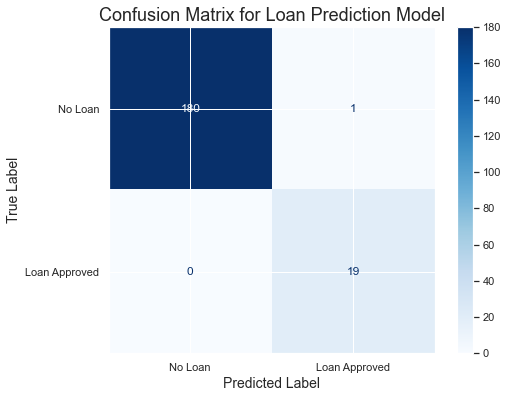

In [ ]:
from sklearn.linear_model import LogisticRegression

# Train the model
model = LogisticRegression()
model.fit(X_train, y_train)

# Predict the test labels
ypred = model.predict(X_test)
# Compute the confusion matrix
cm = confusion_matrix(y_test, y_pred)
# Create a ConfusionMatrixDisplay object and plot the confusion matrix
cm_display = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=['No Loan', 'Loan Approved'])
fig, ax = plt.subplots(figsize=(8, 6))
cm_display.plot(ax=ax, cmap=plt.cm.Blues, values_format='d')
ax.set_title('Confusion Matrix for Loan Prediction Model', fontsize=18)
ax.set_xlabel('Predicted Label', fontsize=14)
ax.set_ylabel('True Label', fontsize=14)
plt.show()


In [ ]:
import pickle
# Saving model to disk
pickle.dump(Regression, open('loan_predictionmodel.pkl','wb'))
model ="loan_predictionmodel.pkl"